<a href="https://colab.research.google.com/github/Globnsk/PYTHON/blob/main/Lesson4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Визуализация данных с Matplotlib и Seaborn

### Подключение библиотек и скриптов

In [ ]:
import numpy as np
import pandas as pd

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
# Считываем датасет
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/bank1.csv', sep = ';')
df.sample(n=10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,convert
36665,32,technician,married,secondary,no,522,yes,yes,cellular,12,may,272,5,258,0
6811,30,services,married,secondary,no,586,yes,no,unknown,28,may,187,4,-1,0
24827,49,management,married,tertiary,no,470,no,no,cellular,18,nov,79,1,-1,0
44797,63,admin.,divorced,secondary,no,4680,no,no,cellular,15,sep,953,2,-1,1
31482,63,self-employed,married,tertiary,no,-39,no,no,cellular,1,apr,387,2,-1,1
15410,36,housemaid,divorced,secondary,no,181,yes,no,cellular,18,jul,354,1,-1,0
4649,34,blue-collar,married,secondary,no,2700,yes,no,unknown,20,may,446,2,-1,0
33957,36,technician,married,secondary,no,24,yes,no,cellular,30,apr,58,1,163,0
24509,55,retired,married,secondary,no,1504,yes,yes,cellular,17,nov,761,1,-1,1
19099,50,admin.,married,secondary,no,4855,no,no,cellular,5,aug,720,2,-1,1


### Стандартный синтаксис создания графика

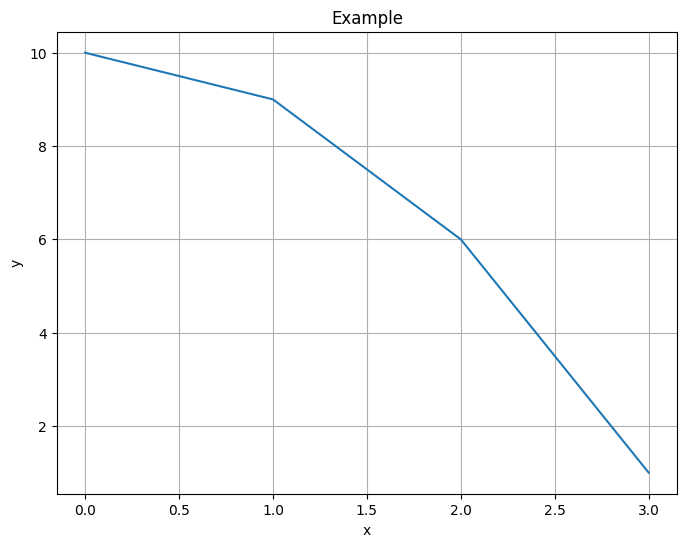

In [ ]:
plt.figure(figsize=(8, 6))
plt.plot([0, 1, 2, 3], [10, 9, 6, 1])
plt.xlabel('x')
plt.ylabel('y')
plt.title('Example')
plt.grid();

## Виды графиков


#### Линейный график

In [ ]:
# Готовим данные для графика в виде сводной таблицы

data = df.groupby('month')['job'].agg(count='count').reset_index().sort_values(by='month')
data.head()

,month,count
0,apr,2932
1,aug,6247
2,dec,214
3,feb,2649
4,jan,1403


#### **Matplotlib**

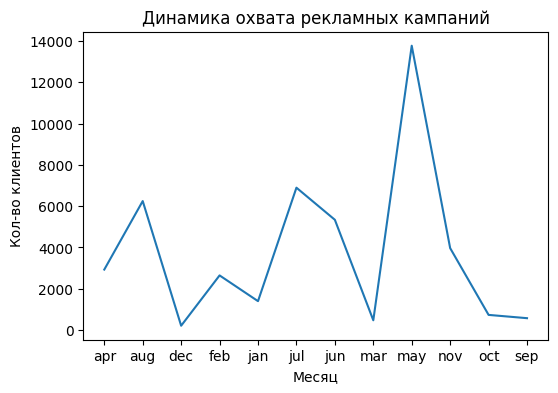

In [ ]:
plt.figure(figsize=(6, 4))

plt.plot(data['month'], data['count'])

plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов');

#### **Seaborn**

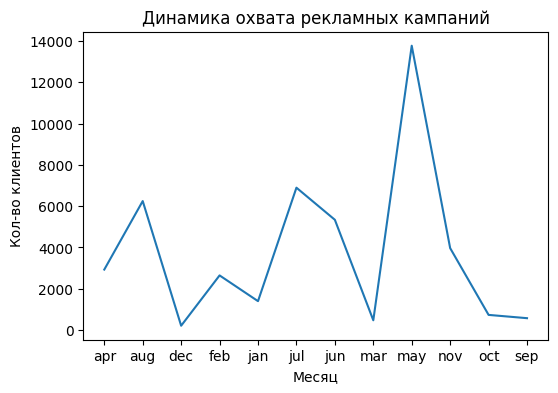

In [ ]:
plt.figure(figsize=(6, 4))

sns.lineplot(x=data['month'], y=data['count'])

plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов');

### **Гистограмма**

#### **Matplotlib**

Text(0, 0.5, 'Кол-во клиентов')

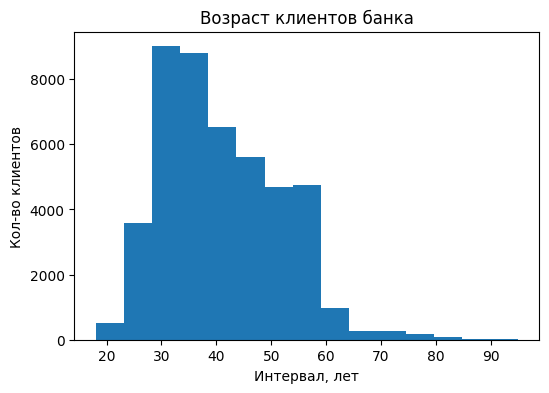

In [ ]:
plt.figure(figsize=(6, 4))

plt.hist(df['age'], bins=15)

plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов')

### **Seaborn**

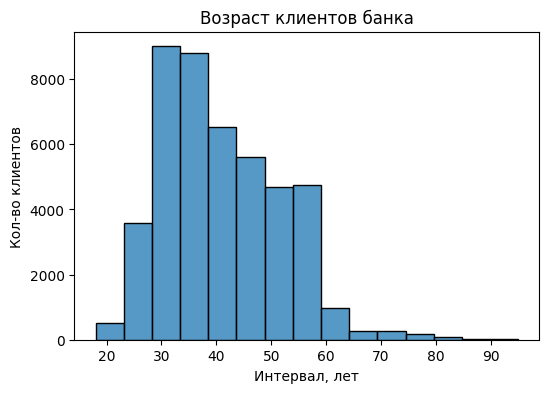

In [ ]:
plt.figure(figsize=(6, 4))

sns.histplot(df['age'], bins=15)

plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов');

### **Диаграмма рассеяния**

In [ ]:
# Готовим данные для графика в виде сводной таблицы
data = df.groupby('age')['convert'].sum().reset_index()
data.head()

,age,convert
0,18,7
1,19,11
2,20,15
3,21,22
4,22,40


#### **Matplotlib**

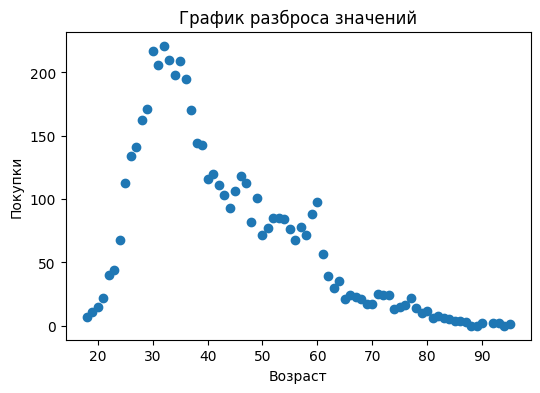

In [ ]:
plt.figure(figsize=(6, 4))

plt.scatter(data['age'], data['convert'])

plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Покупки');

#### **Seaborn**

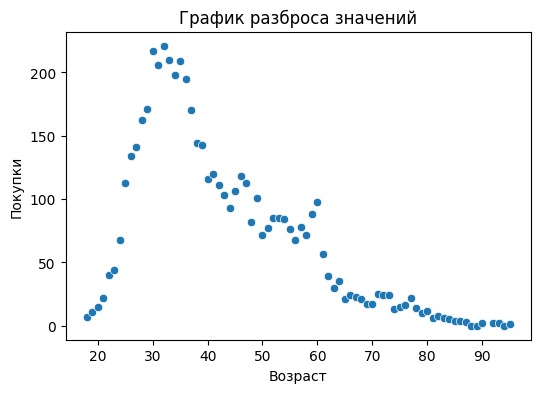

In [ ]:
plt.figure(figsize=(6, 4))

sns.scatterplot(x=data['age'], y=data['convert'])

plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Покупки');

### **Столбчатые диаграммы**

In [ ]:
# Готовим данные для графика
data = df['job'].value_counts().reset_index()
data.head()

,job,count
0,blue-collar,9732
1,management,9458
2,technician,7597
3,admin.,5171
4,services,4154


#### **Matplotlib**

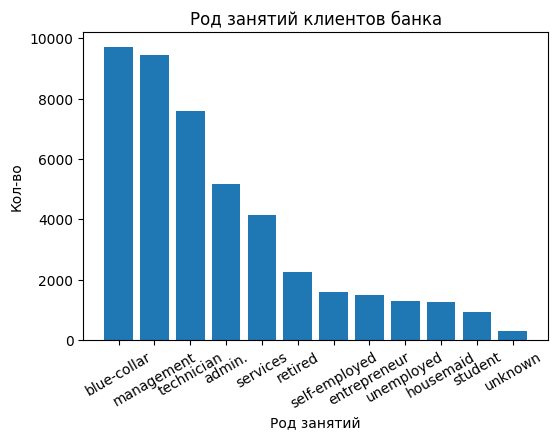

In [ ]:
plt.figure(figsize=(6, 4))

plt.bar(data['job'], data['count'])

plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.xticks(rotation=30);

#### **Seaborn**

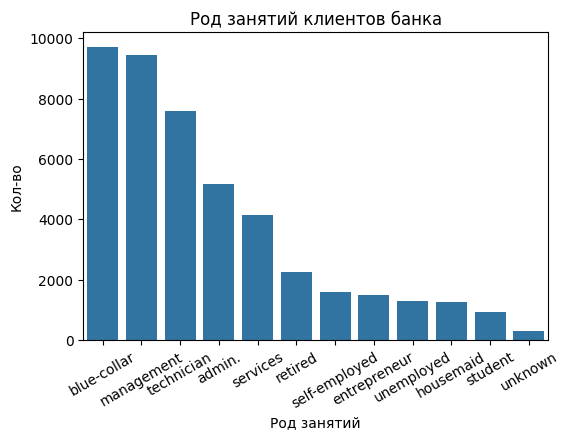

In [ ]:
plt.figure(figsize=(6, 4))

sns.barplot(x=data['job'], y=data['count'])

plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.xticks(rotation=30);

#### **Многорядовые столбчатые диаграммы**

In [ ]:
# Готовим данные для графика
data = pd.crosstab(df['job'], df['convert']).reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

convert,job,no,yes
1,blue-collar,9024,708
4,management,8157,1301
9,technician,6757,840
0,admin.,4540,631
7,services,3785,369


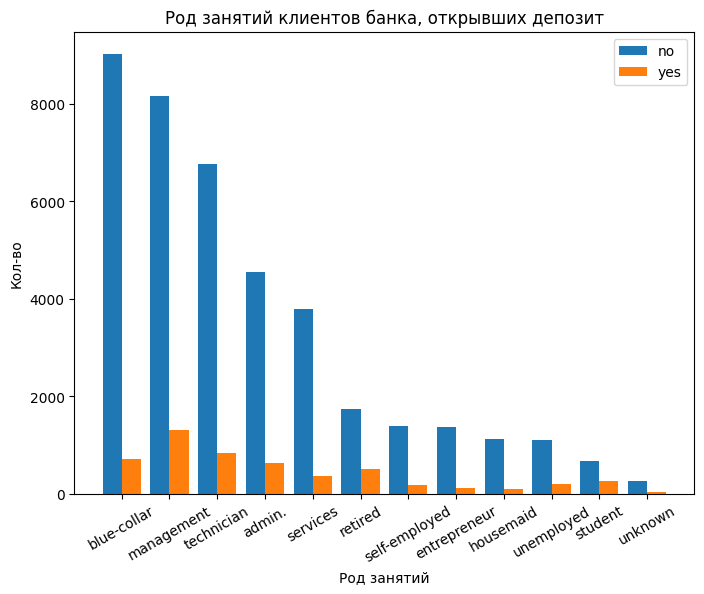

In [ ]:
# Строим столбчатую многорядную диаграмму

plt.figure(figsize=(8, 6))

# определяем кол-во делений
n_ticks = np.arange(len(data['no']))

# определяем сдвиг
offset = 0.2

# определяем ширину столбцов
w = 0.4

# добавляем сдвиг к кол-ву делений
plt.bar(n_ticks - offset, data['no'], width=w)
plt.bar(n_ticks + offset, data['yes'], width=w)

plt.title('Род занятий клиентов банка, открывших депозит')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.legend(['no', 'yes'])
plt.xticks(n_ticks, data['job'], rotation = 30);  # добавляем метки делений

#### **Сложенная столбчатая диаграмма**

In [ ]:
# Готовим данные для графика
data = pd.crosstab(df['job'], df['convert'], normalize='index').reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

convert,job,no,yes
1,blue-collar,0.927250,0.072750
2,entrepreneur,0.917283,0.082717
3,housemaid,0.912097,0.087903
7,services,0.911170,0.088830
9,technician,0.889430,0.110570


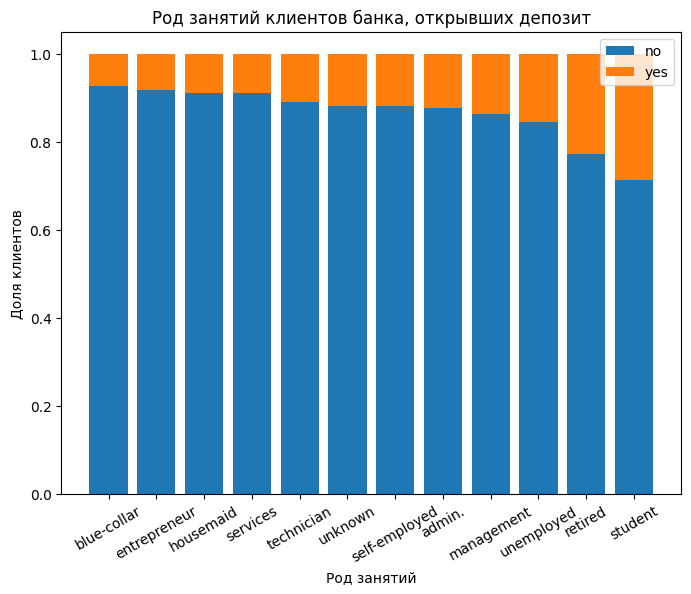

In [ ]:
# Строим столбчатую многорядную сложенную диаграмму

plt.figure(figsize=(8, 6))

plt.bar(data['job'], data['no'])
plt.bar(data['job'], data['yes'], bottom=data['no'])

plt.title('Род занятий клиентов банка, открывших депозит')
plt.xlabel('Род занятий')
plt.ylabel('Доля клиентов')
plt.legend(['no', 'yes'])
plt.xticks(rotation = 30);


### **Ящики с усами**

In [ ]:
# Готовим данные для графика
data1 = df['duration'][df['convert'] == 1]
data2 = df['duration'][df['convert'] == 0]
data1.head()

,duration
83,1042
86,1467
87,1389
129,579
168,673


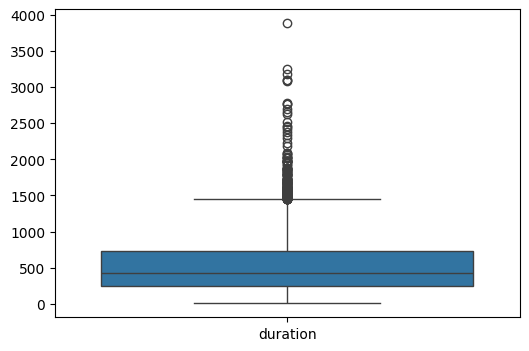

In [ ]:
plt.figure(figsize=(6, 4))

sns.boxplot(data=[data1]);

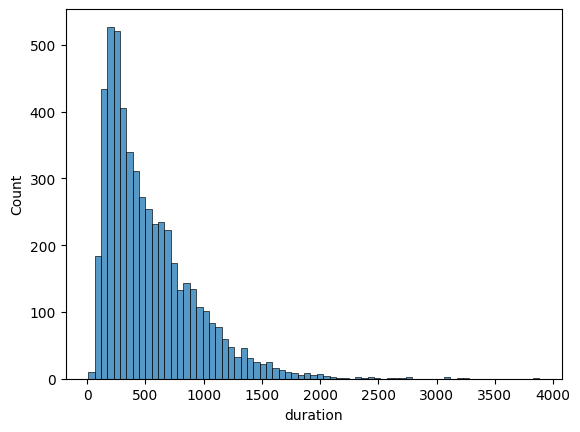

In [ ]:
sns.histplot(x=data1);

#### **Matplotlib**

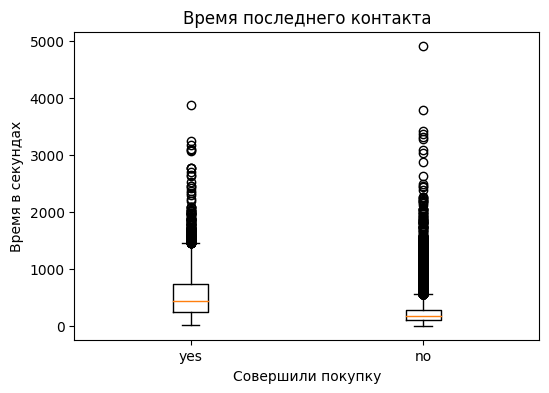

In [ ]:
# Строим боксплот

plt.figure(figsize=(6, 4))

plt.boxplot([data1, data2])

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')
plt.ylabel('Время в секундах')
plt.xticks([1, 2], ['yes', 'no']);

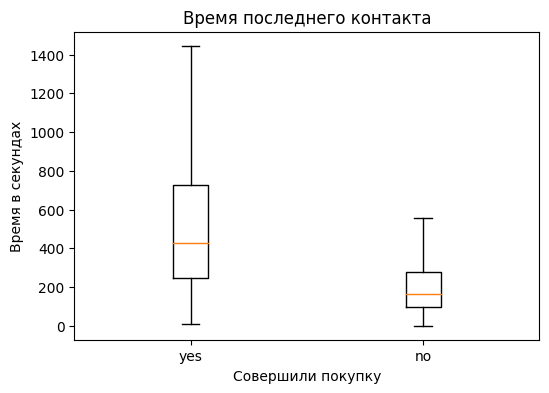

In [ ]:
# Строим боксплот без выбросов

plt.figure(figsize=(6, 4))

plt.boxplot([data1, data2], showfliers=False)

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')

plt.ylabel('Время в секундах')
plt.xticks([1, 2], ['yes', 'no']);

#### **Seaborn**

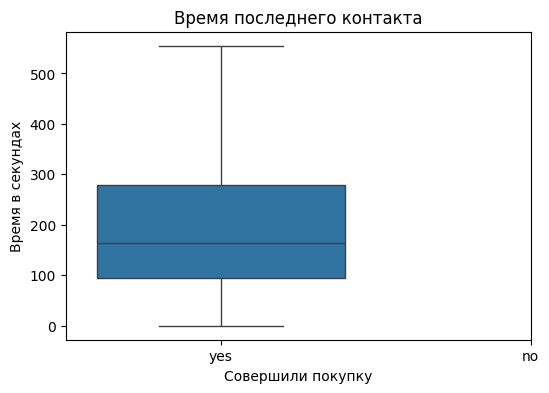

In [ ]:
# Строим боксплот без выбросов

# Строим боксплот без выбросов

plt.figure(figsize=(6, 4))

sns.boxplot(data=[data1, data2], showfliers=False)

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')

plt.ylabel('Время в секундах')
plt.xticks([0, 1], ['yes', 'no']);



### **Круговая диаграмма**

In [ ]:
# Готовим данные для графика
data = df['convert'].value_counts()
data.index = ['no', 'yes']
data.head()

,count
no,39922
yes,5289


### **Matplotlib**

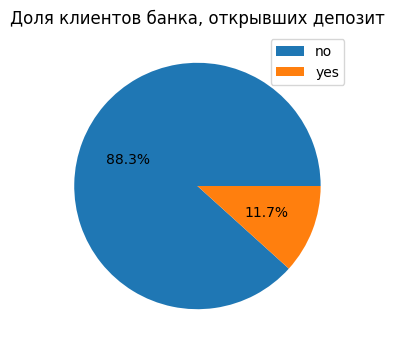

In [ ]:
# Строим круговую диаграмму

plt.figure(figsize=(6, 4))

plt.pie(data, autopct='%1.1f%%')

plt.title('Доля клиентов банка, открывших депозит')
plt.legend(data.index);

## **Визуальный анализ данных**
### **Описание датасета**

####Статистические данные о ряде домов в Калифорнии, основанные на переписи 1990 года.

#####longitude - долгота
#####latitude - широта
#####housing_median_age - средний возраст дома
#####total_rooms - общее количество комнат
#####total_bedrooms - общее количество спален
#####population - количество проживающих
#####households - домохозяйства
#####ocean_proximity - близость океана
#####median_income - средний доход
#####median_house_value - средняя стоимость дома



In [ ]:

df = pd.read_csv('/content/sample_data/california_housing_train.csv')
df

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
0,-114.31,34.19,15.0,5612.0,1283.0,1015.0,472.0,1.4936,66900.0
1,-114.47,34.40,19.0,7650.0,1901.0,1129.0,463.0,1.8200,80100.0
2,-114.56,33.69,17.0,720.0,174.0,333.0,117.0,1.6509,85700.0
3,-114.57,33.64,14.0,1501.0,337.0,515.0,226.0,3.1917,73400.0
4,-114.57,33.57,20.0,1454.0,326.0,624.0,262.0,1.9250,65500.0
...,...,...,...,...,...,...,...,...,...
16995,-124.26,40.58,52.0,2217.0,394.0,907.0,369.0,2.3571,111400.0
16996,-124.27,40.69,36.0,2349.0,528.0,1194.0,465.0,2.5179,79000.0
16997,-124.30,41.84,17.0,2677.0,531.0,1244.0,456.0,3.0313,103600.0
16998,-124.30,41.80,19.0,2672.0,552.0,1298.0,478.0,1.9797,85800.0


### **Распределение вещественных признаков**

In [ ]:
# {'red', 'green', 'blue'} - дискретный признак ('red', 'green', 'blue', 'red', 'green', 'red')
# [0, 100] - вещественный признак (0, 5, 5.6, 10.5, 10.57)

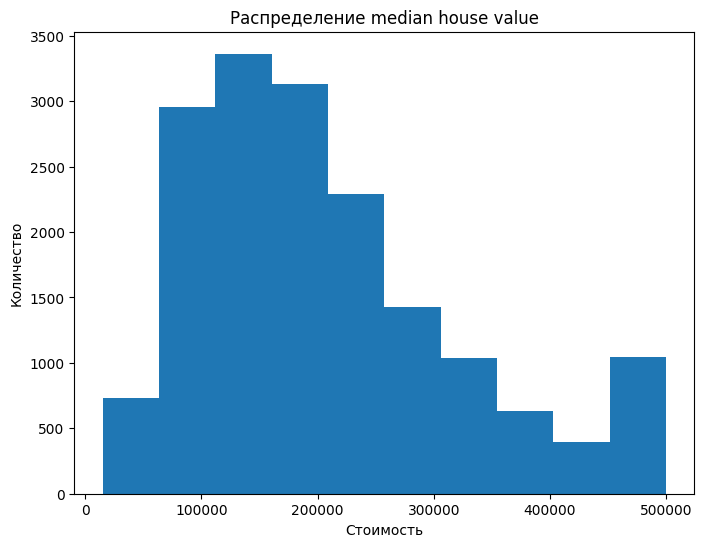

In [ ]:
plt.figure(figsize=(8, 6))
plt.hist(df['median_house_value'])
plt.title('Распределение median house value')
plt.xlabel('Стоимость')
plt.ylabel('Количество');

In [ ]:
df_num_features = df.select_dtypes(include=['float64', 'float32', 'float16'])
df_num_features.drop('median_house_value', axis=1, inplace=True)

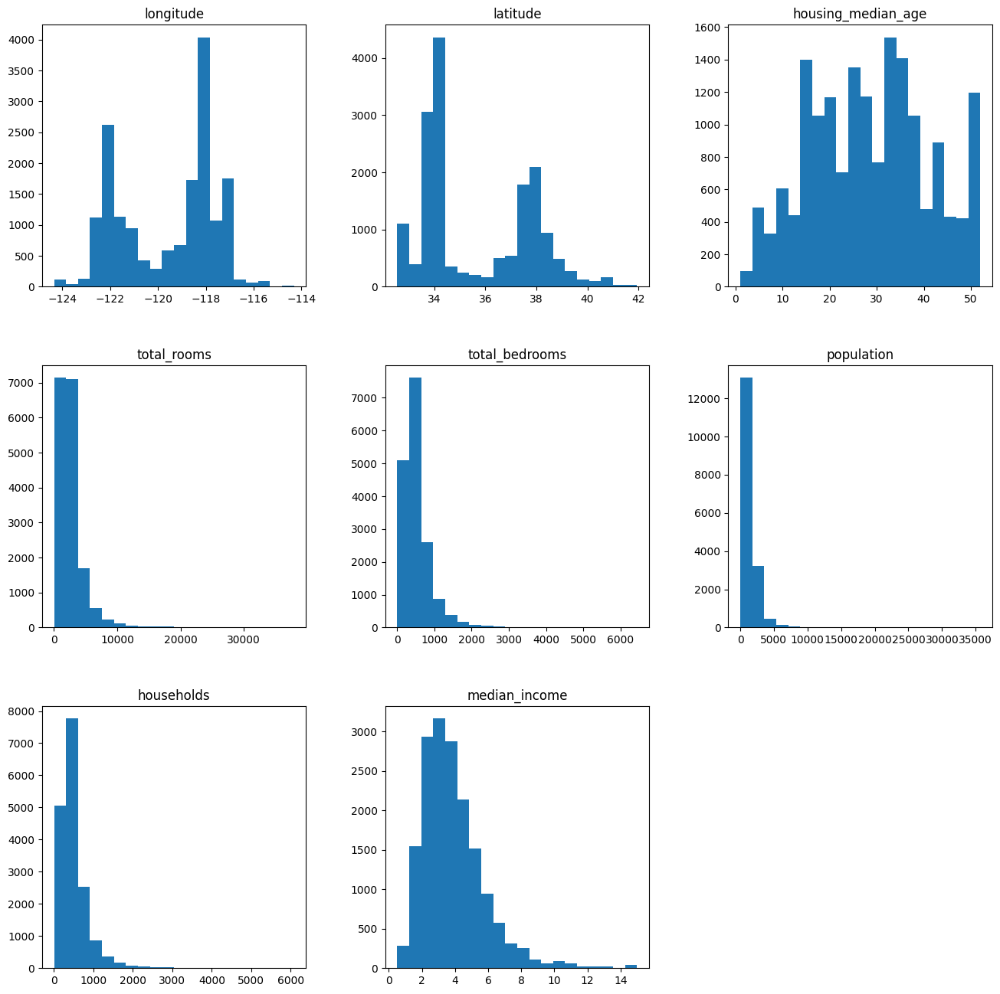

In [ ]:
df_num_features.hist(figsize=(16, 16), bins=20, grid=False);

## **Поиск выбросов с помощью box plot**

#### **Как строится box plot**

#####Подробное объяснение

######box - от 25% до 75% квантиля
######линия в середине box - медиана
######"усы"
######Как строятся "усы" - вариантов масса

######среднее +/- 3 сигма (стандартное отклонение)
######min / max
######median +/- 1.5*(q75 - q25),
######...
######*Интерквартильный размах = q75 - q25

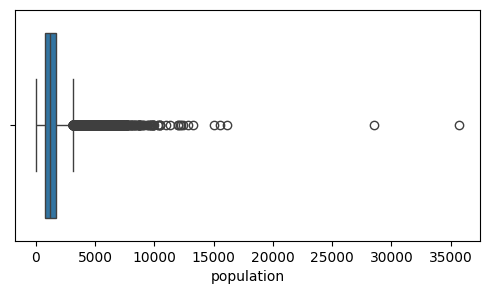

In [ ]:
plt.figure(figsize=(6, 3))

sns.boxplot(x=df['population'], whis=1.5)

plt.xlabel('population')
plt.show()

##### Дорисуем 2 столбца и заполним их случайными значениями

In [ ]:
inland = ['NEAR OCEAN','NEAR BAY','ISLAND', 'INLAND', '1H OCEAN']

In [ ]:
df['ocean_proximity'] = np.random.choice(list(inland), len(df))
df['INLAND'] = np.random.choice((0,1), len(df))
df

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,INLAND
0,-114.31,34.19,15.0,5612.0,1283.0,1015.0,472.0,1.4936,66900.0,1H OCEAN,1
1,-114.47,34.40,19.0,7650.0,1901.0,1129.0,463.0,1.8200,80100.0,ISLAND,0
2,-114.56,33.69,17.0,720.0,174.0,333.0,117.0,1.6509,85700.0,NEAR BAY,1
3,-114.57,33.64,14.0,1501.0,337.0,515.0,226.0,3.1917,73400.0,INLAND,0
4,-114.57,33.57,20.0,1454.0,326.0,624.0,262.0,1.9250,65500.0,NEAR BAY,0
...,...,...,...,...,...,...,...,...,...,...,...
16995,-124.26,40.58,52.0,2217.0,394.0,907.0,369.0,2.3571,111400.0,1H OCEAN,0
16996,-124.27,40.69,36.0,2349.0,528.0,1194.0,465.0,2.5179,79000.0,NEAR BAY,1
16997,-124.30,41.84,17.0,2677.0,531.0,1244.0,456.0,3.0313,103600.0,NEAR BAY,1
16998,-124.30,41.80,19.0,2672.0,552.0,1298.0,478.0,1.9797,85800.0,NEAR BAY,0


###**Анализ категориальных признаков**

<ipython-input-95-0932fcc46449>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=counts.index, y=counts.values, palette='Set2')


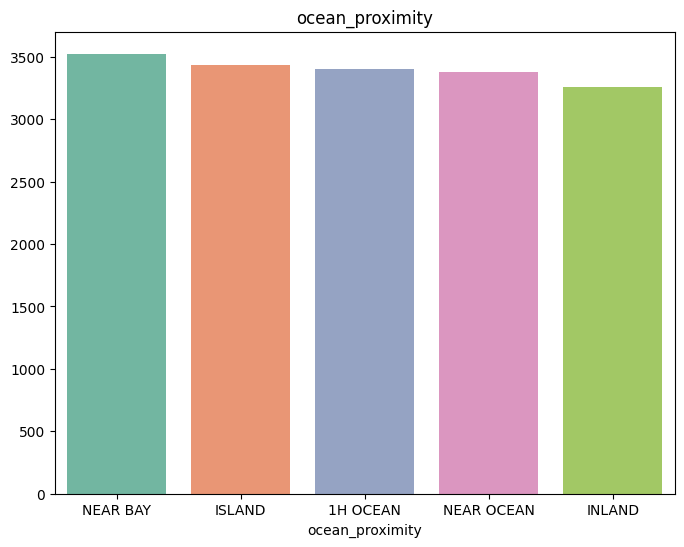

In [ ]:
counts = df['ocean_proximity'].value_counts()

plt.figure(figsize=(8, 6))
plt.title('ocean_proximity')
sns.barplot(x=counts.index, y=counts.values, palette='Set2')

plt.show()

<ipython-input-97-18370d7757a5>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=counts.index, y=counts.values, palette='Set2')


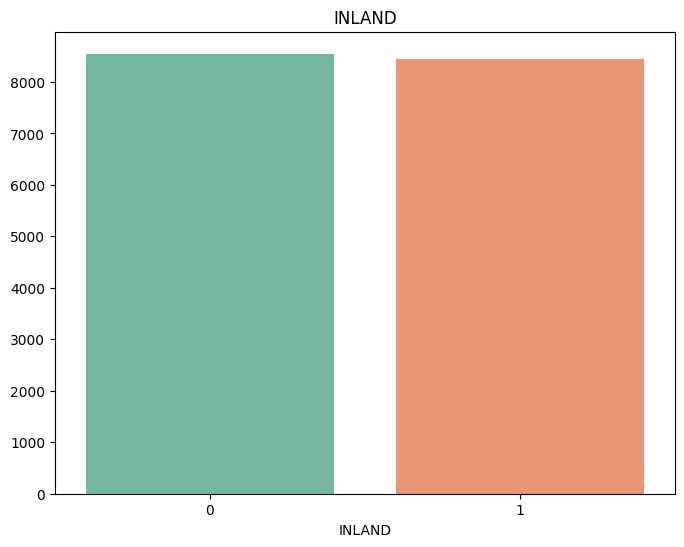

In [ ]:
counts = df['INLAND'].value_counts()

plt.figure(figsize=(8, 6))
plt.title('INLAND')
sns.barplot(x=counts.index, y=counts.values, palette='Set2')

plt.show()

### **Анализ взаимных распределений**

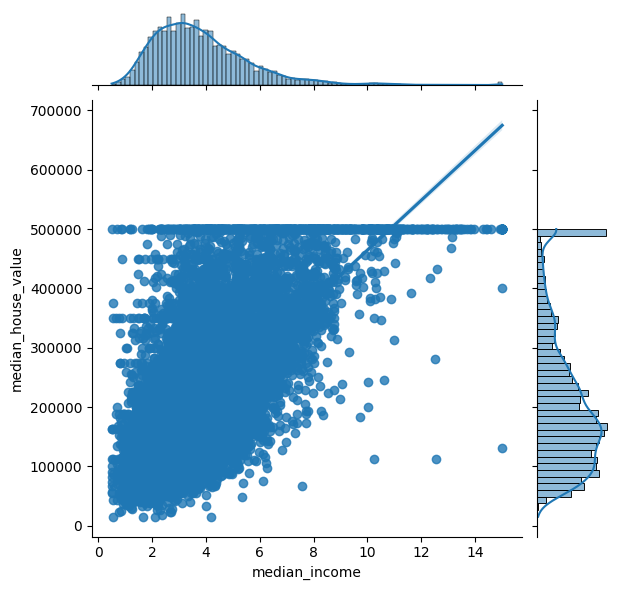

In [ ]:
sns.jointplot(x=df['median_income'], y=df['median_house_value'], kind='reg');

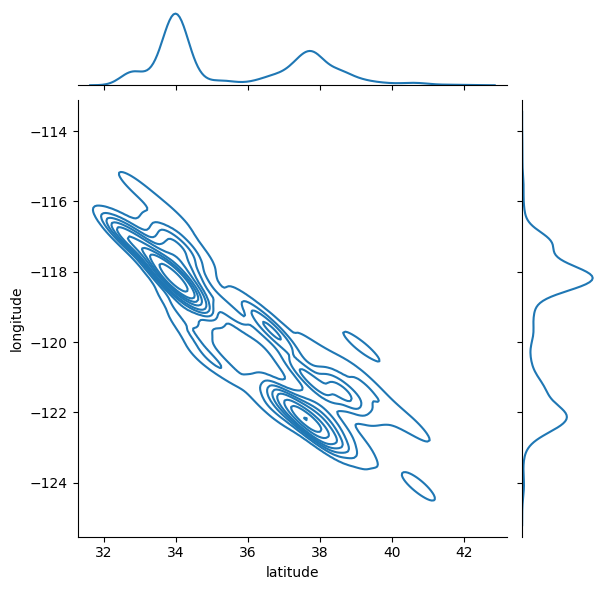

In [ ]:
sns.jointplot(x=df['latitude'], y=df['longitude'], kind='kde');

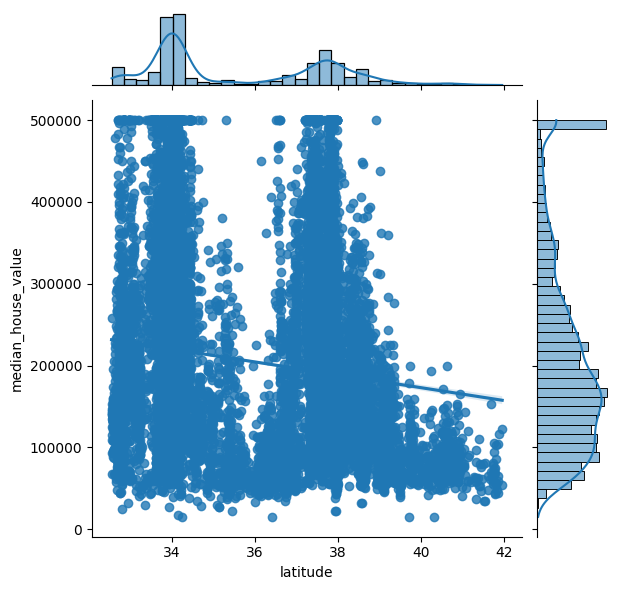

In [ ]:
sns.jointplot(x=df['latitude'], y=df['median_house_value'], kind='reg');

#####Видно два города, имеет смысл посмотреть на зависимость по отдельности

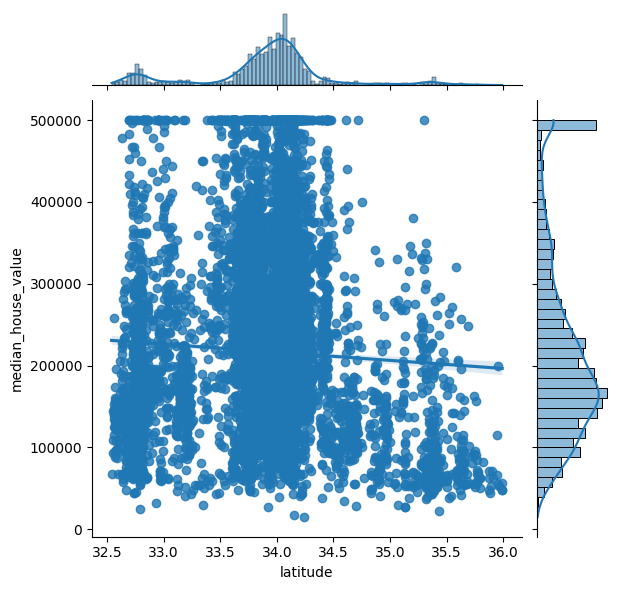

In [ ]:
df_cut = df[df['latitude'] < 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

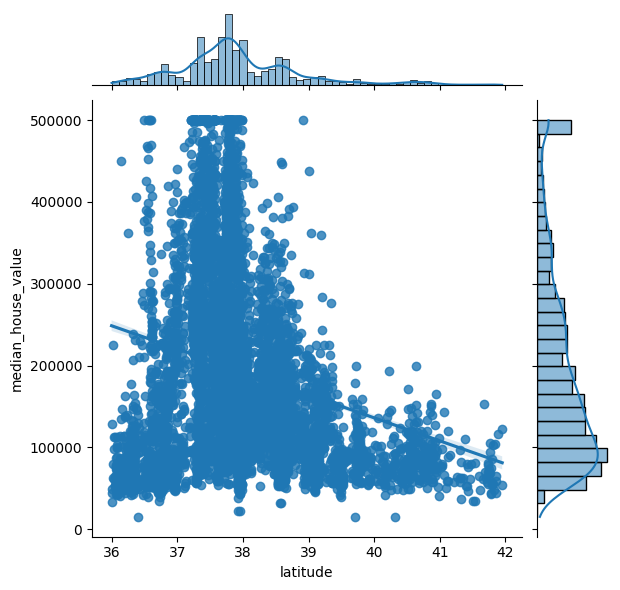

In [ ]:
df_cut = df[df['latitude'] >= 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

#####longitude

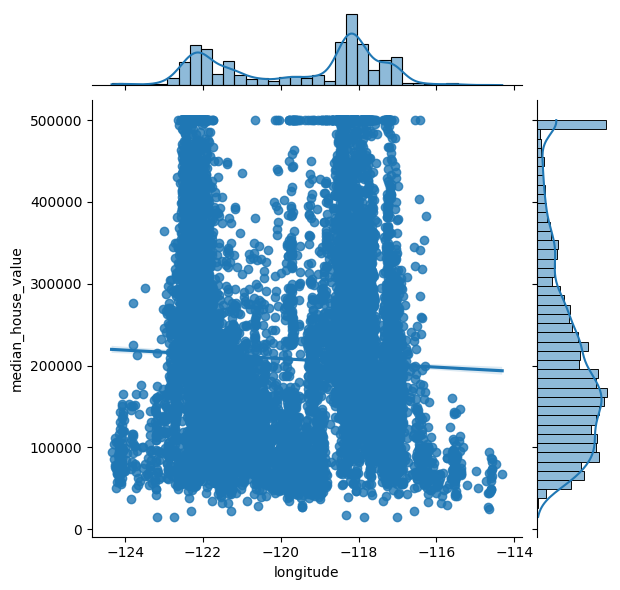

In [ ]:
sns.jointplot(x=df['longitude'], y=df['median_house_value'], kind='reg');

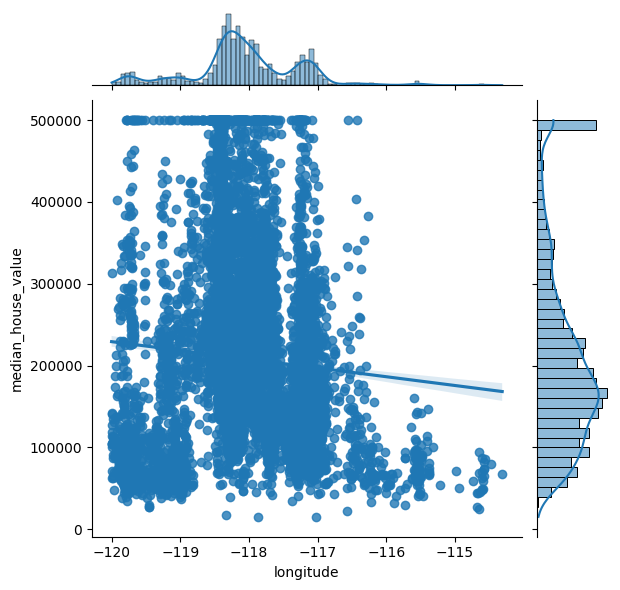

In [ ]:
df_cut = df[df['longitude'] >= -120]
sns.jointplot(x=df_cut['longitude'], y=df_cut['median_house_value'], kind='reg');

###**Категориальные / бинарные признаки**

####box plot

/usr/local/lib/python3.10/dist-packages/dateutil/parser/_parser.py:1207: UnknownTimezoneWarning: tzname OCEAN identified but not understood.  Pass `tzinfos` argument in order to correctly return a timezone-aware datetime.  In a future version, this will raise an exception.
  warnings.warn("tzname {tzname} identified but not understood.  "
<ipython-input-110-7a25b5722eaa>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=df['median_house_value'], y=df['ocean_proximity'], whis=1.5, palette = 'Set2')
/usr/local/lib/python3.10/dist-packages/dateutil/parser/_parser.py:1207: UnknownTimezoneWarning: tzname OCEAN identified but not understood.  Pass `tzinfos` argument in order to correctly return a timezone-aware datetime.  In a future version, this will raise an exception.
  warnings.warn("tzname {tzname} identified but not understood.  "


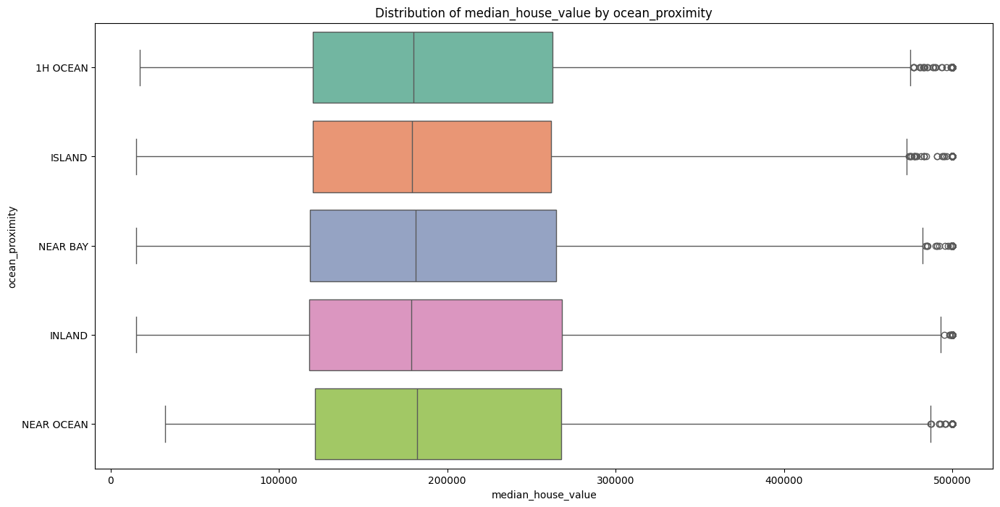

In [ ]:
plt.figure(figsize=(16, 8))

sns.boxplot(x=df['median_house_value'], y=df['ocean_proximity'], whis=1.5, palette = 'Set2')

plt.xlabel('median_house_value')
plt.ylabel('ocean_proximity')
plt.title('Distribution of median_house_value by ocean_proximity');

### **Как строится box plot**

#### **Подробное объяснение**

#####box - от 25% до 75% квантиля
#####линия в середине box - медиана
#####"усы"
#####Как строятся "усы" - вариантов масса

#####среднее +/- 3 сигма (стандартное отклонение)
#####min / max
#####median +/- 1.5*(q75 - q25),
#####...
#####*Интерквартильный размах = q75 - q25

###**Матрица корреляций**
#####Показывает линейную связь между переменными
#####Изменяется от -1 до 1
#####Корреляция - мера только линейной связи

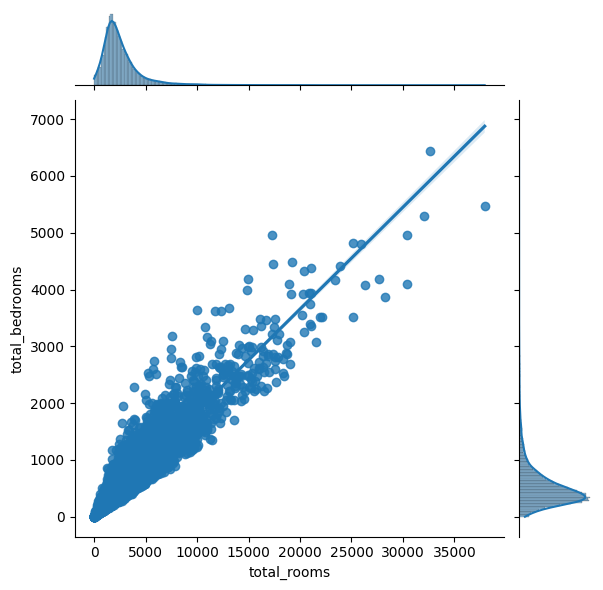

In [ ]:
sns.jointplot(x=df['total_rooms'], y=df['total_bedrooms'], kind='reg');

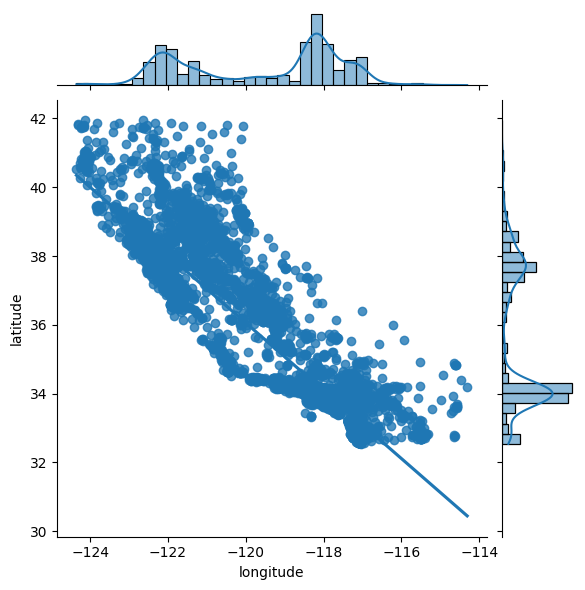

In [ ]:
sns.jointplot(x=df['longitude'], y=df['latitude'], kind='reg');


In [ ]:
df

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,INLAND
0,-114.31,34.19,15.0,5612.0,1283.0,1015.0,472.0,1.4936,66900.0,1H OCEAN,1
1,-114.47,34.40,19.0,7650.0,1901.0,1129.0,463.0,1.8200,80100.0,ISLAND,0
2,-114.56,33.69,17.0,720.0,174.0,333.0,117.0,1.6509,85700.0,NEAR BAY,1
3,-114.57,33.64,14.0,1501.0,337.0,515.0,226.0,3.1917,73400.0,INLAND,0
4,-114.57,33.57,20.0,1454.0,326.0,624.0,262.0,1.9250,65500.0,NEAR BAY,0
...,...,...,...,...,...,...,...,...,...,...,...
16995,-124.26,40.58,52.0,2217.0,394.0,907.0,369.0,2.3571,111400.0,1H OCEAN,0
16996,-124.27,40.69,36.0,2349.0,528.0,1194.0,465.0,2.5179,79000.0,NEAR BAY,1
16997,-124.30,41.84,17.0,2677.0,531.0,1244.0,456.0,3.0313,103600.0,NEAR BAY,1
16998,-124.30,41.80,19.0,2672.0,552.0,1298.0,478.0,1.9797,85800.0,NEAR BAY,0


In [ ]:
df = df.drop(columns=['ocean_proximity'])
df

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,INLAND
0,-114.31,34.19,15.0,5612.0,1283.0,1015.0,472.0,1.4936,66900.0,1
1,-114.47,34.40,19.0,7650.0,1901.0,1129.0,463.0,1.8200,80100.0,0
2,-114.56,33.69,17.0,720.0,174.0,333.0,117.0,1.6509,85700.0,1
3,-114.57,33.64,14.0,1501.0,337.0,515.0,226.0,3.1917,73400.0,0
4,-114.57,33.57,20.0,1454.0,326.0,624.0,262.0,1.9250,65500.0,0
...,...,...,...,...,...,...,...,...,...,...
16995,-124.26,40.58,52.0,2217.0,394.0,907.0,369.0,2.3571,111400.0,0
16996,-124.27,40.69,36.0,2349.0,528.0,1194.0,465.0,2.5179,79000.0,1
16997,-124.30,41.84,17.0,2677.0,531.0,1244.0,456.0,3.0313,103600.0,1
16998,-124.30,41.80,19.0,2672.0,552.0,1298.0,478.0,1.9797,85800.0,0


In [ ]:
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,INLAND
longitude,1.0,-0.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
latitude,-0.9,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
housing_median_age,0.0,0.0,1.0,-0.4,-0.3,-0.3,-0.3,0.0,0.0,0.0
total_rooms,0.0,0.0,-0.4,1.0,0.9,0.9,0.9,0.0,0.0,0.0
total_bedrooms,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0,0.0
population,0.0,0.0,-0.3,0.9,0.9,1.0,0.9,0.0,0.0,0.0
households,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0,0.0
median_income,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.7,0.0
median_house_value,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7,1.0,0.0
INLAND,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


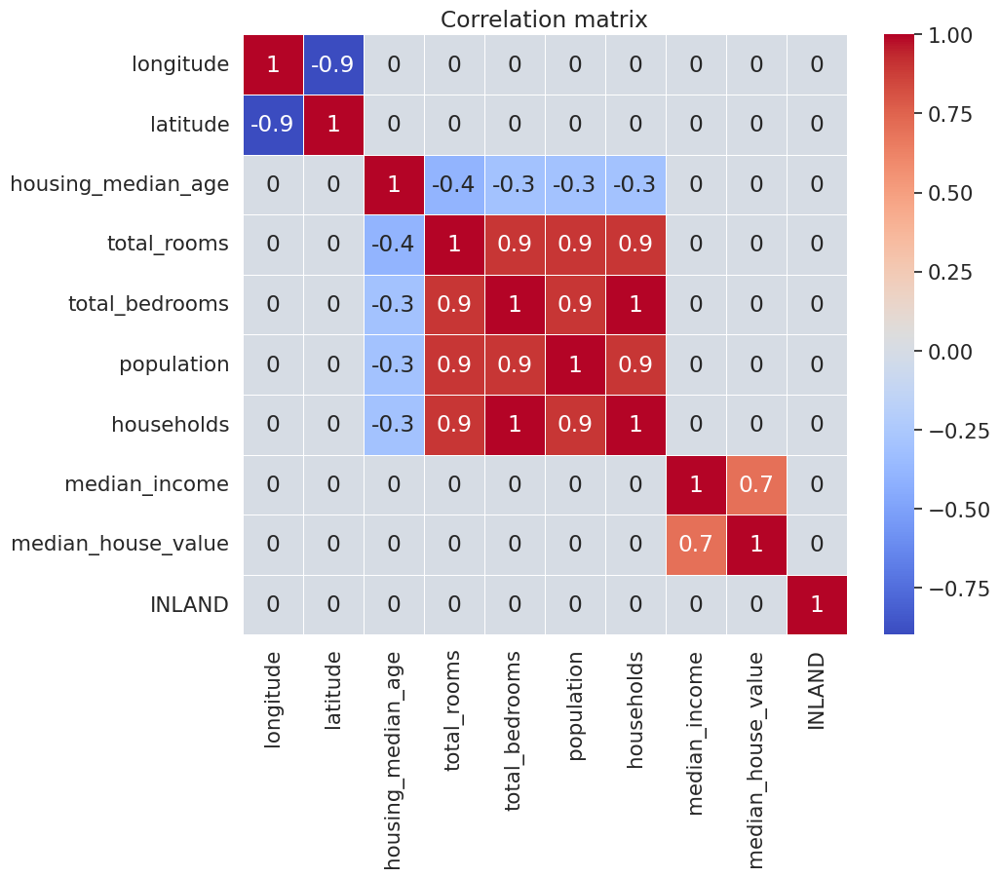

In [ ]:
plt.figure(figsize=(10, 8))

sns.set(font_scale=1.4)

sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')

plt.title('Correlation matrix');

###**Гео данные**

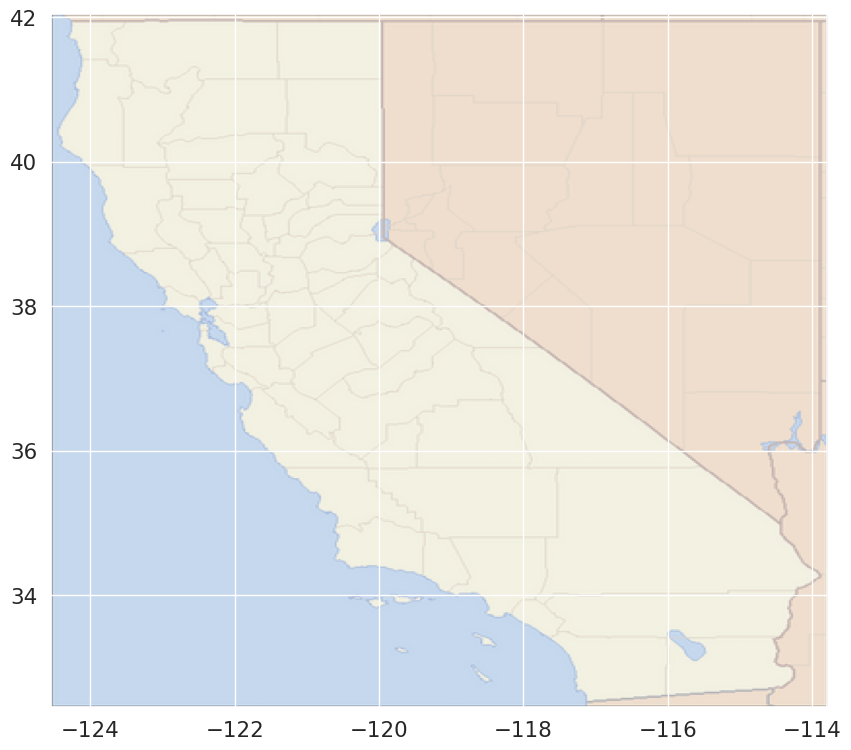

In [ ]:
min_long = -124.55
max_long = -113.80

min_lat = 32.45
max_lat = 42.05
import matplotlib.image as img
california_map = img.imread('/content/drive/MyDrive/Colab Notebooks/California_map.png')

plt.figure(figsize=(12, 9))
plt.imshow(california_map,
           extent=[min_long, max_long, min_lat, max_lat], alpha=0.5);

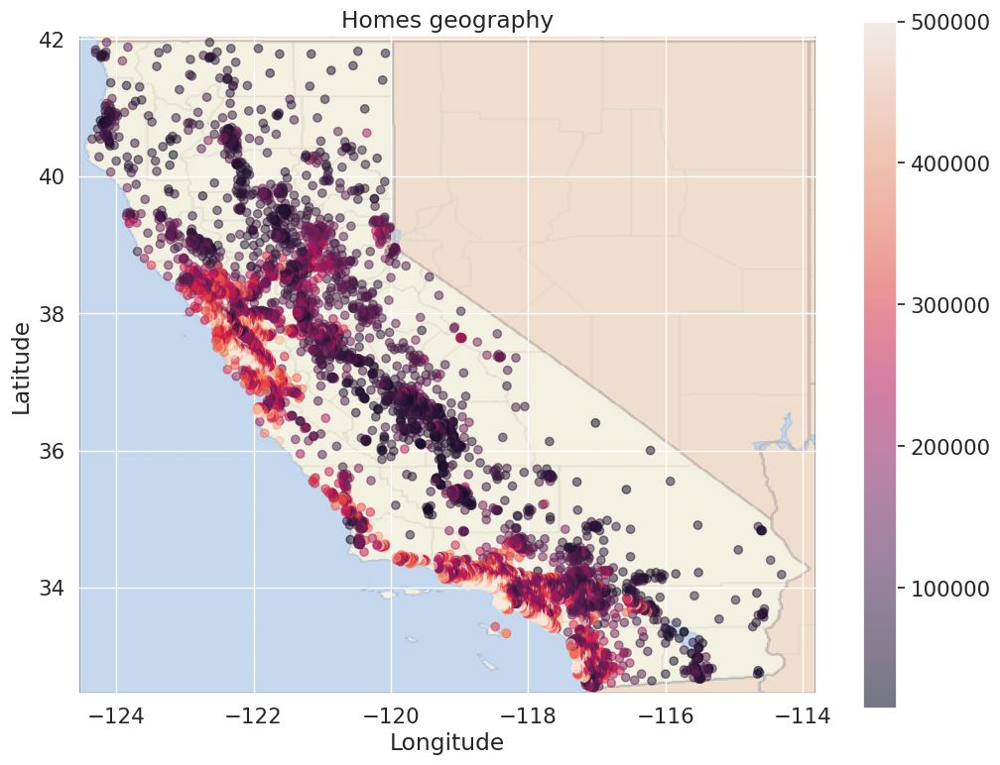

In [ ]:
plt.figure(figsize=(12, 9))

sc = plt.scatter(df['longitude'], df['latitude'], alpha=0.5, c=df['median_house_value'])

plt.imshow(california_map,
           extent=[min_long, max_long, min_lat, max_lat], alpha=0.5)

plt.colorbar(sc)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Homes geography");

####**Folium**

In [ ]:
# !pip install folium

In [ ]:
import folium
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    folium.CircleMarker(
        location=[point.latitude, point.longitude],
        radius=2,
        popup=point.median_house_value
    ).add_to(this_map)

df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map

In [ ]:
from keplergl import KeplerGl

map_ = KeplerGl(height=700)
map_.add_data(df, 'Data')
map_.save_to_html(file_name='./california.html')

ModuleNotFoundError: No module named 'keplergl'

#### **Summary
####Матрица корреляции
####Знакомство с признаками
####Плотность распределения (sns.distplot/sns.kdeplot/plt.hist - Узнать распределение признака)
####sns.violinplot - Узнать распределение признака
####Столбчатая диаграмма (sns.barplot/plt.bar - Узнать распределение категориального признака)
####Ящик с усами (sns.boxplot/plt.boxplot - Узнать диапазон значений)
####sns.jointplot - Взаимное изменение признаков
####plt.pie - Изобразить долю объектов от всего кол-ва
####Поиск выбросов
####sns.distplot/sns.kdeplot/plt.hist - Искать хвосты слева и справа
####sns.boxplot - Всё, что выходит за пределы усов - выбросы
####Seaborn - https://seaborn.pydata.org/examples/index.html
####Matplotlib - https://matplotlib.org/3.1.0/gallery/index.html